# Student Attendance calculation

### 

### Import library

In [1]:
import json
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
f = open('course_schedules 1st_pro.json', encoding="utf8")
data = json.load(f)
df = pd.DataFrame(data)
df=df.loc[df['status'] == "completed"]

In [3]:
attendance=[]
Name=[]
present=[]
absent=[]
pending=[]
auto_a=[]
manual_a=[]
auto_p=[]
manual_p=[]

student_auto_p=[]
student_manual_p=[]
all_student=[]

In [4]:
for no ,session in df.iterrows():
    for i in session["staffs"]:
        first=i["staff_name"]["first"]
        last=i["staff_name"]["last"]
        Name.append(" ".join([first, last]))
        present_=0
        absent_=0
        pending_=0
        auto_a_=0
        manual_a_=0
        auto_p_=0
        manual_p_=0
        student_auto_p_=[]
        student_manual_p_=[]
        for i in session["students"]:
            f=i["name"]["first"]
            l=i["name"]["last"]
            all_student.append(" ".join([f, l]))
            if i["status"]=="absent":
                absent_+=1
                try:
                    if i["mode"]=="auto":
                        auto_a_+=1
                    elif i["mode"]=="manual":
                        manual_a_+=1
                except:
                    continue 
                
            elif i["status"]=="pending":
                pending_+=1
            
            elif i["status"]=="present":
                present_+=1
                try:
                    if i["mode"]=="auto":
                        first=i["name"]["first"]
                        last=i["name"]["last"]
                        student_auto_p_.append(" ".join([first, last]))
                        auto_p_+=1
                    elif i["mode"]=="manual":
                        first=i["name"]["first"]
                        last=i["name"]["last"]
                        student_manual_p_.append(" ".join([first, last]))
                        manual_p_+=1
                except:
                    continue
        #status.append(" ".join([str(present_), str(absent_),str(pending_),str(auto_a_),str(manual_a_),str(auto_p_),str(manual_p_)]))
        present.append(str(present_))
        absent.append(str(absent_))
        pending.append(str(pending_))
        auto_a.append(str(auto_a_))
        manual_a.append(str(manual_a_))
        auto_p.append(str(auto_p_))
        manual_p.append(str(manual_p_))
        student_auto_p.append(student_auto_p_)
        student_manual_p.append(student_manual_p_)

In [5]:
df = pd.DataFrame(list(zip(Name,present,absent,pending,auto_a,manual_a,auto_p,manual_p,student_auto_p,student_manual_p)),columns =["Name","present","absent","pending","auto_a","manual_a","auto_p","manual_p","student_auto_p","student_manual_p"])

In [6]:
df

,Name,present,absent,pending,auto_a,manual_a,auto_p,manual_p,student_auto_p,student_manual_p
0,MARWA MOHAMED SAFWAT,28,0,0,0,0,0,28,[],"[ADEL A ALDORWISH, ABDULLAH A ALRASHID, FADI S..."
1,MUAZZAM MAQBUL,5,0,0,0,0,1,4,[Liale Oukal],"[Lamis Aljohani, Renad ALmalki, Hanin AL otibi..."
2,Solafa Azzouz,35,0,0,0,0,3,32,"[Aneesa S, Ghada Abudlkareem Alalaawi, Refal ...","[Dummy8 Dummy8, Salma Hussain, Raghad Nasser B..."
3,RUKHSANA SATAR,87,0,0,0,0,30,57,"[BAYAN QASSEM QATTAB, ANWAAR MURTADAH BANJABI,...","[TAHANI AL MAATAIRI, WEJDAN TAHA ALYENBAAWI, R..."
4,Asmaa Elbakry,105,0,0,0,0,2,103,"[Aneesa S, Ghada Abudlkareem Alalaawi]","[Dummy8 Dummy8, Salma Hussain, Raghad Nasser B..."
...,...,...,...,...,...,...,...,...,...,...
18190,Shaima Tariq,75,2,0,0,0,0,75,[],"[MOHAMMED MERAI MAHOJAA, AMJAD YAPAH MAYATEH, ..."
18191,AHMED ALNAWAJHA,75,2,0,0,0,0,75,[],"[MOHAMMED MERAI MAHOJAA, AMJAD YAPAH MAYATEH, ..."
18192,Dharani dhakshan,0,2,0,1,0,0,0,[],[]
18193,Dharani dhakshan,1,1,0,0,0,1,0,[Test4 Test4],[]


In [7]:
MARWA_df=df.loc[df['Name'] == "MARWA MOHAMED SAFWAT"]

In [8]:
MARWA_df.head()

,Name,present,absent,pending,auto_a,manual_a,auto_p,manual_p,student_auto_p,student_manual_p
0,MARWA MOHAMED SAFWAT,28,0,0,0,0,0,28,[],"[ADEL A ALDORWISH, ABDULLAH A ALRASHID, FADI S..."
14,MARWA MOHAMED SAFWAT,154,0,0,0,0,33,121,"[Abdullah A Bahakim, ABDULLAH MUSTAFA BAKHADLA...","[Amro Wan Gah, SALEH A ALMOTARI, ABDULLAH M AB..."
77,MARWA MOHAMED SAFWAT,105,0,0,0,0,71,34,"[LAMA ALZAHRANI, KHLOOD AQLAN, ZENAB AL ABDULM...","[SHAYKHAH BIN SIFRAN, REHAM ALHARBI, NEHAL KHO..."
108,MARWA MOHAMED SAFWAT,30,0,0,0,0,15,15,"[AHMED T KIKI, YAHYA KHAN POODAKHAN, LYANA BAB...","[AMMAR S KILLANI, HAITHAM MABKHOOT AHMED, AHME..."
122,MARWA MOHAMED SAFWAT,30,0,0,0,0,14,16,"[AHMED T KIKI, YAHYA KHAN POODAKHAN, LYANA BAB...","[AMMAR S KILLANI, HAITHAM MABKHOOT AHMED, AHME..."


In [9]:
MARWA_auto=0
MARWA_manual=0

In [10]:
for no ,session in MARWA_df.iterrows():
    for i in session["student_auto_p"]:
        if i=="LAMA ALZAHRANI":
            MARWA_auto+=1
    for i in session["student_manual_p"]:
        if i=="LAMA ALZAHRANI":
            MARWA_manual+=1      

In [11]:
pie=(MARWA_auto,MARWA_manual)

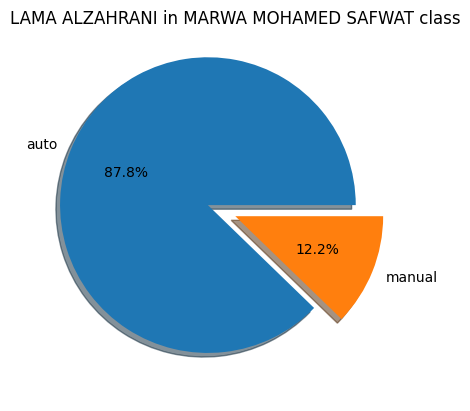

In [12]:
mylabels = ["auto", "manual"]
myexplode = [0.2, 0]
plt.title("LAMA ALZAHRANI in MARWA MOHAMED SAFWAT class")
plt.pie(pie,labels = mylabels, explode = myexplode, shadow = True,autopct='%1.1f%%')
plt.show() 

In [13]:
len(all_student)

768818

In [14]:
all_student=set(all_student)

In [15]:
len(all_student)

1885

In [16]:
name=[]
pie=[]
per=[]
classes=[]

In [17]:
for stu in all_student:
    auto=0
    manual=0
    class_=0
    name.append(stu)
    for no ,session in MARWA_df.iterrows():
        for i in session["student_auto_p"]:
            if i==stu:
                auto+=1
                class_+=1
        for i in session["student_manual_p"]:
            if i==stu:
                manual+=1
                class_+=1
    classes.append(class_)
    pie_=(auto,manual)
    pie.append(pie_)
    per_=auto+manual
    if per_ !=0:
        per_=(auto/per_)*100
        per.append(per_)
    else:
        per.append("0")

In [18]:
len(classes)

1885

In [19]:
chart_data = pd.DataFrame(list(zip(name,pie,per,classes)),columns =["Name","pie","per","classes"])

In [20]:
chart_data['per'] = chart_data['per'].astype(int)

In [21]:
chart_data

,Name,pie,per,classes
0,MAWADA J KINSARA,"(8, 11)",42,19
1,Amnah Jawhali,"(0, 0)",0,0
2,LAYAN AWDAH,"(17, 7)",70,24
3,Ghena Habib,"(0, 0)",0,0
4,MUAAZ A ALKHATIB,"(0, 1)",0,1
...,...,...,...,...
1880,AMJAD HEJJI ALDADI,"(0, 0)",0,0
1881,ABDEIRAHMAN HAMDI ALSAYED,"(0, 0)",0,0
1882,Lama Alghamdi,"(15, 3)",83,18
1883,MOHAMMED SAFWAN WUHUD,"(13, 1)",92,14


In [22]:
chart_data.loc[chart_data['Name'] == "AHMED T KIKI"]

,Name,pie,per,classes
346,AHMED T KIKI,"(8, 2)",80,10


In [23]:
chart_data=chart_data.sort_values(['per'])

In [24]:
chart_data=chart_data.loc[chart_data['pie'] != (0, 0)]

In [25]:
chart_data

,Name,pie,per,classes
936,Rafeef saeed,"(0, 4)",0,4
956,ABDULLAH ALNAHDI,"(0, 6)",0,6
899,Atheer Awad ALharbi,"(0, 2)",0,2
1473,Elaf Salem A Badurees Elaf Salem A Badurees,"(0, 7)",0,7
889,WESAM IBRAHIEM MAYET,"(0, 1)",0,1
...,...,...,...,...
1836,MOHAMMED A ALHARBI,"(5, 0)",100,5
1843,ABDULLAH Alolyan,"(11, 0)",100,11
73,MOSTAFA MOSTAFA ABBADY,"(1, 0)",100,1
529,ANAS ADNAN ZAHRAN,"(15, 0)",100,15


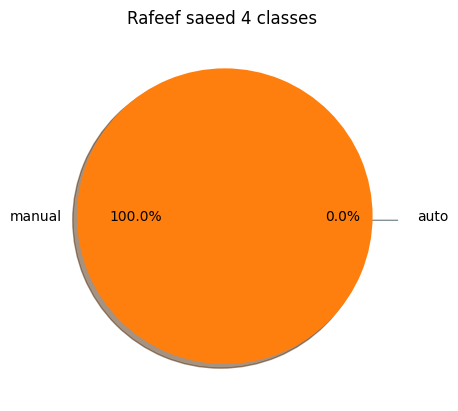

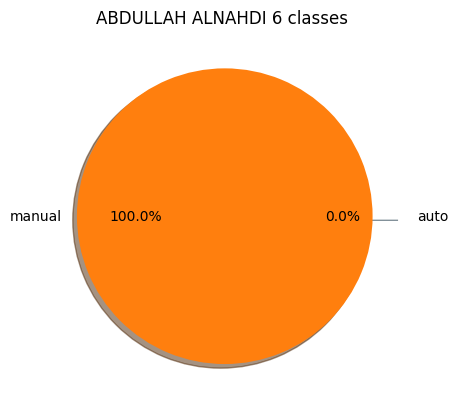

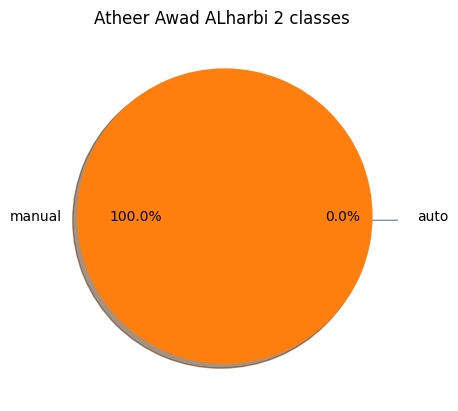

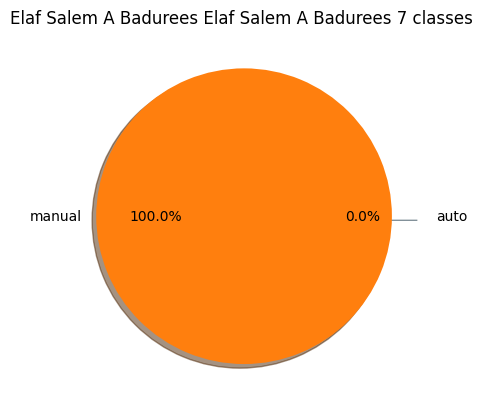

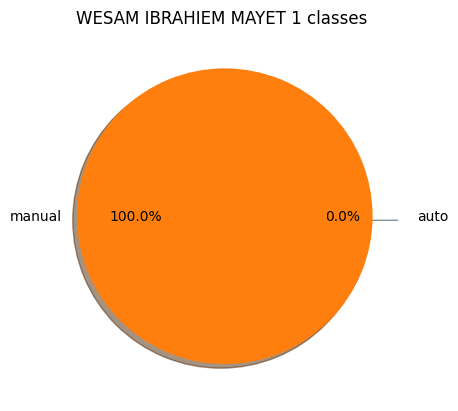

...

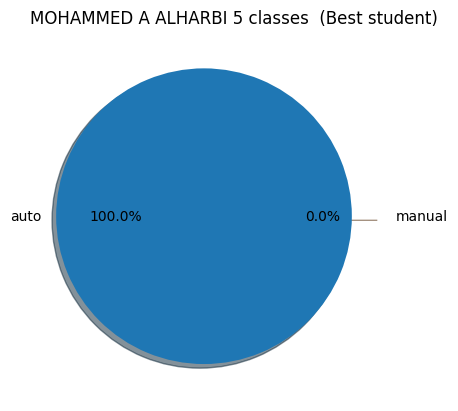

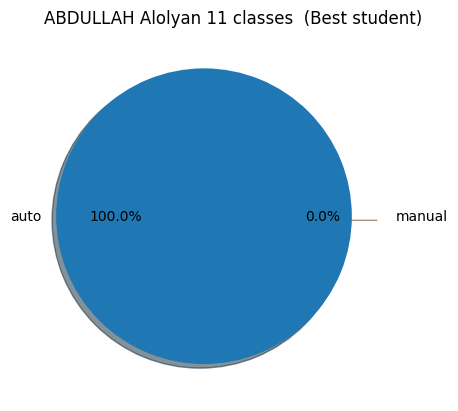

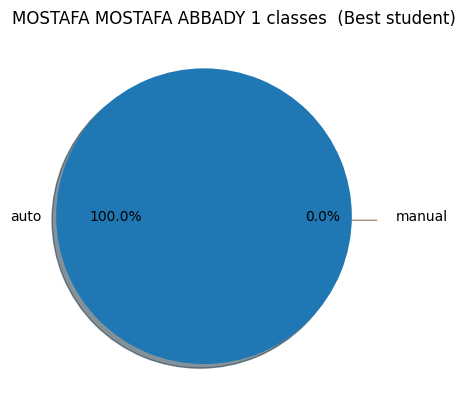

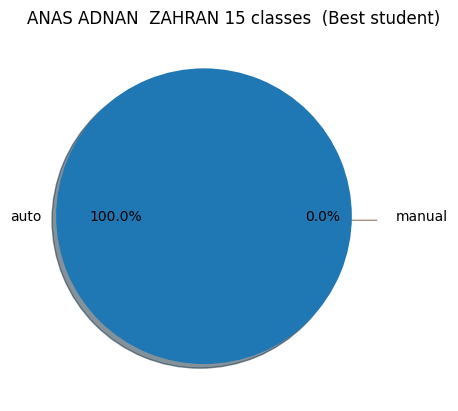

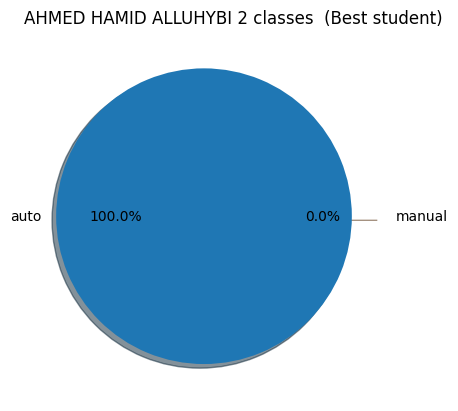

In [26]:
for no ,session in chart_data.iterrows():
    #print(session["Name"])
    if session["pie"]!=(0, 0):
        if session["per"] >= 90:
            lan=" (Best student)"
        else:
            lan=""
        mylabels = ["auto", "manual"]
        myexplode = [0.2, 0]
        plt.title(session["Name"]+" "+str(session["classes"])+" classes "+lan)
        plt.pie(session["pie"],labels = mylabels, explode = myexplode, shadow = True,autopct='%1.1f%%')
        plt.show() 
        print("""

        """)